<a href="https://colab.research.google.com/github/MLCrats/Yolov5-E-Waste-Detection/blob/Vice777-patch-1/yolov5_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(42)

## Hyperparameters and Constants

Here, we define wether to train the model or not and for how many epochs to train for.

If `TRAIN = False`, then the last trained model will be used for inference in the notebook if run end to end.

In [ ]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 300

## Dataset
mount from drive

### The Dataset YAML File

The dataset YAML (`data.yaml`) file containing the path to the training and validation images and labels is already provided. This file will also contain the class names from the dataset.

The dataset contains 5 classes: **['Battery', 'Capacitor', 'Cirtuit-Board', 'IoT Sensor', 'LCD', 'Regulator', 'Resistor', 'Switches']**.

The following block shows the contents of the `data.yaml` file.

```yaml
train: ../train/images
val: ../val/images
test: ../test/images

nc: 5
names: ['Battery', 'Capacitor', 'Cirtuit-Board', 'IoT Sensor', 'LCD', 'Regulator', 'Resistor', 'Switches']
```

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pwd

'/content'

In [ ]:
parent = r'/content'
folders = ['test', 'train', 'val']

for folder in folders:
    path = os.path.join(parent,folder)
    os.mkdir(path)

In [ ]:
cd /content/test

/content/test


In [ ]:
os.makedirs(os.path.join('images'), exist_ok=True)
os.makedirs(os.path.join('labels'), exist_ok=True)

In [ ]:
cd /content/train

/content/train


In [ ]:
os.makedirs(os.path.join('images'), exist_ok=True)
os.makedirs(os.path.join('labels'), exist_ok=True)

In [ ]:
cd /content/val

/content/val


In [ ]:
os.makedirs(os.path.join('images'), exist_ok=True)
os.makedirs(os.path.join('labels'), exist_ok=True)

In [ ]:
import shutil
src = '/content/drive/MyDrive/Imagine cup material/Dataset/data.yaml'
dest = '/content'
shutil.copy(src, dest )
        

## Import all the test images - test
src = '/content/drive/MyDrive/Imagine cup material/Dataset/test/images'
dest = '/content/test/images'
for src_file in os.listdir(src):
    shutil.copy((os.path.join(src,src_file)), dest )

## Import all the test labels
src = '/content/drive/MyDrive/Imagine cup material/Dataset/test/labels'
dest = '/content/test/labels'
for src_file in os.listdir(src):
    shutil.copy((os.path.join(src,src_file)), dest )

## Import all the train images - train
src = '/content/drive/MyDrive/Imagine cup material/Dataset/train/images'
dest = '/content/train/images'
for src_file in os.listdir(src):
    shutil.copy((os.path.join(src,src_file)), dest )

## Import all the train labels
src = '/content/drive/MyDrive/Imagine cup material/Dataset/train/labels'
dest = '/content/train/labels'
for src_file in os.listdir(src):
    shutil.copy((os.path.join(src,src_file)), dest )

## Import all the val images - val
src = '/content/drive/MyDrive/Imagine cup material/Dataset/val/images'
dest = '/content/val/images'
for src_file in os.listdir(src):
    shutil.copy((os.path.join(src,src_file)), dest )

## Import all the val labels
src = '/content/drive/MyDrive/Imagine cup material/Dataset/val/labels'
dest = '/content/val/labels'
for src_file in os.listdir(src):
    shutil.copy((os.path.join(src,src_file)), dest )

In [ ]:
class_names = ['Battery', 'Capacitor', 'Cirtuit-Board', 'IoT Sensor', 'LCD', 'Regulator', 'Resistor', 'Switches']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

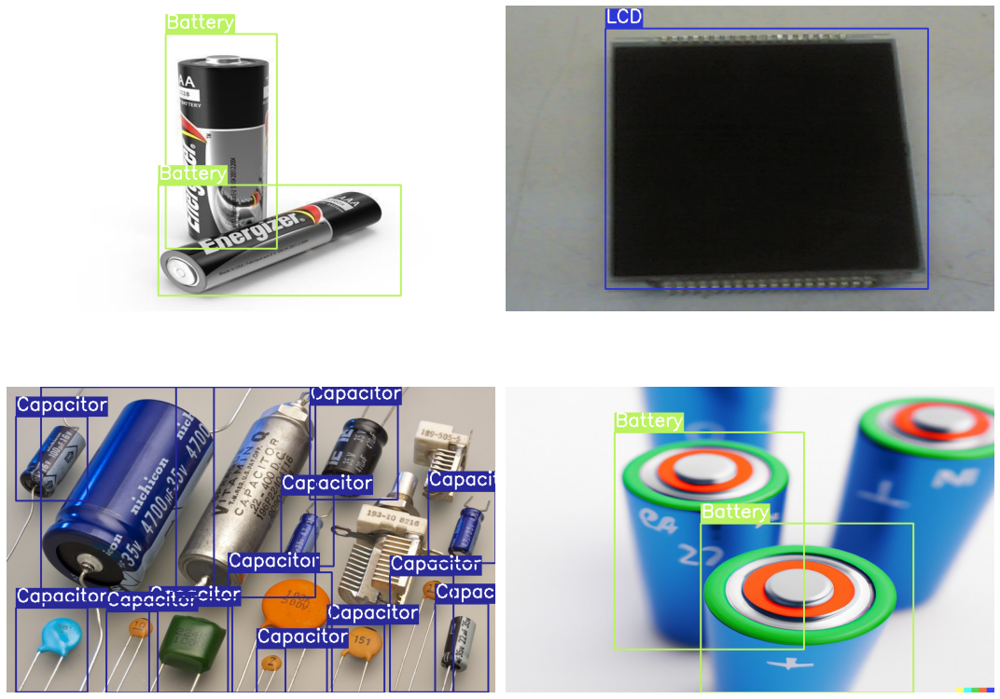

In [ ]:
# Visualize a few training images.
plot(
    image_paths='/content/train/images/*', 
    label_paths='/content/train/labels/*',
    num_samples=4,
)

## Helper Functions for Logging

Here, we write the helper functions that we need for logging of the results in the notebook while training the models.

Let's create our custom result directories so that we can easily keep track of them and carry out inference using the proper model.

In [ ]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

**Function to Monitor TensorBoard logs**.

In [ ]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

## Clone YOLOV5 Repository

In [ ]:
cd /content

/content


In [ ]:
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 14927, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (16/16), done.
remote: Total 14927 (delta 7), reused 13 (delta 3), pack-reused 14908
Receiving objects: 100% (14927/14927), 14.01 MiB | 14.62 MiB/s, done.
Resolving deltas: 100% (10246/10246), done.


In [ ]:
%cd yolov5/
%pwd

/content/yolov5


'/content/yolov5'

In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 17.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.4 MB/s eta 0:00:00


## Training using YOLOV5

The next step is to train the neural network model.

### Train a Small (yolov5s) Model

Training all the layers of the small model.

In [ ]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

In [ ]:
cd '/content/yolov5'

/content/yolov5


In [ ]:
RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

Streaming output truncated to the last 5000 lines.
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
    149/299      7.44G    0.02308    0.01117   0.002629         57        640:   6% 1/18 [00:00<00:08,  2.01it/s]libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: known incorrect sRGB profile
    149/299      7.44G     0.0266    0.01346    0.01381         70        640:  17% 3/18 [00:01<00:06,  2.18it/s]libpng warning: iCCP: known incorrect sRGB profile
libpng warning: iCCP: cHRM chunk does not match sRGB
    149/299      7.44G     0.0252    0.01267    0.01141         54        640:  22% 4/18 [00:01<00:05,  2.34it/s]libpng warning: iCCP: known incorrect sRGB profile
    149/299      7.44G    0.02442    0.01242   0.008323         47        640:  33% 6/18 [00:02<00:05,  2.25it/s]libpng w

In [ ]:
!zip -r /content/train_run.zip /content/yolov5/runs

  adding: content/yolov5/runs/ (stored 0%)
  adding: content/yolov5/runs/train/ (stored 0%)
  adding: content/yolov5/runs/train/results_2/ (stored 0%)
  adding: content/yolov5/runs/train/results_2/confusion_matrix.png (deflated 19%)
  adding: content/yolov5/runs/train/results_2/opt.yaml (deflated 49%)
  adding: content/yolov5/runs/train/results_2/val_batch1_labels.jpg (deflated 27%)
  adding: content/yolov5/runs/train/results_2/P_curve.png (deflated 7%)
  adding: content/yolov5/runs/train/results_2/labels_correlogram.jpg (deflated 30%)
  adding: content/yolov5/runs/train/results_2/val_batch0_labels.jpg (deflated 11%)
  adding: content/yolov5/runs/train/results_2/results.csv (deflated 83%)
  adding: content/yolov5/runs/train/results_2/weights/ (stored 0%)
  adding: content/yolov5/runs/train/results_2/weights/best.pt (deflated 8%)
  adding: content/yolov5/runs/train/results_2/weights/last.pt (deflated 8%)
  adding: content/yolov5/runs/train/results_2/train_batch0.jpg (deflated 10%)
  add

## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [ ]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

The following functions are for carrying out inference on images and videos.

In [ ]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR}
    return INFER_DIR

We may also need to visualize images in any of the directories. The following function accepts a directory path and plots all the images in them. 

In [ ]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

**Visualize validation prediction images.**

confusion_matrix.png				    results.csv
events.out.tfevents.1672926170.17c2f76cea19.3393.0  results.png
F1_curve.png					    train_batch0.jpg
hyp.yaml					    train_batch1.jpg
labels_correlogram.jpg				    train_batch2.jpg
labels.jpg					    val_batch0_labels.jpg
opt.yaml					    val_batch0_pred.jpg
P_curve.png					    val_batch1_labels.jpg
PR_curve.png					    val_batch1_pred.jpg
R_curve.png					    weights
['runs/train/results_2/val_batch0_pred.jpg', 'runs/train/results_2/val_batch1_pred.jpg']


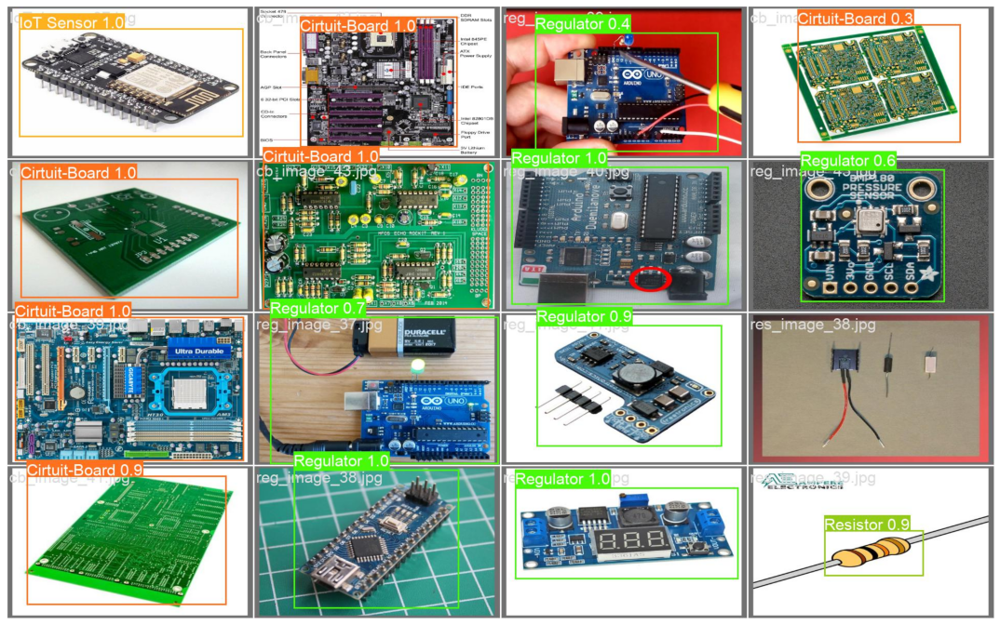

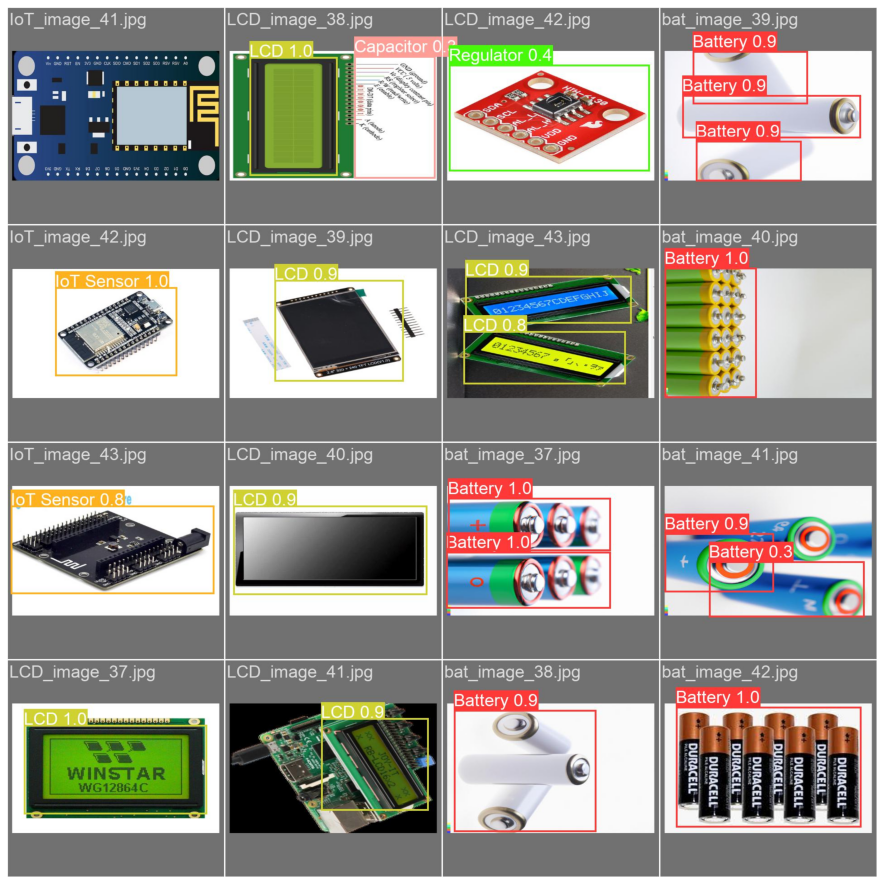

In [ ]:
show_valid_results(RES_DIR)

### Inference
In this section, we will carry out inference on unseen images and videos from the internet. 

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images and Videos
Let's download the images and videos that we will carry inference upon.

In [ ]:
'''download_file('https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip',
              'inference_data.zip')
if not os.path.exists('inference_images'):
    !unzip -q "inference_data.zip"
else:
    print('Dataset already present')'''

File already present, skipping download...
Dataset already present


### Inference on Images

**To carry out inference on images, we just need to provide the directory path where all the images are stored, and inference will happen on all images automatically.**

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images')

Current number of inference detection directories: 0
inference_1
detect: weights=['runs/train/results_2/weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_1, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-56-gc0ca1d2 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20881221 parameters, 0 gradients, 47.9 GFLOPs
image 1/56 /content/test/images/IoT_image_44.jpg: 416x640 1 IoT Sensor, 26.2ms
image 2/56 /content/test/images/IoT_image_45.jpg: 416x640 2 Cirtuit-Boards, 1 IoT Sensor, 32.8ms
image 3/56 /content/test/images/IoT_image_46.jpg: 416x640 1 IoT Sensor, 29.2ms
image 4/56 /conte

['runs/detect/inference_1/cb_image_49.jpg', 'runs/detect/inference_1/swi_image_46.jpg', 'runs/detect/inference_1/cap_image_45.jpg', 'runs/detect/inference_1/reg_image_44.jpg', 'runs/detect/inference_1/LCD_image_44.jpg', 'runs/detect/inference_1/reg_image_47.jpg', 'runs/detect/inference_1/bat_image_49.jpg', 'runs/detect/inference_1/swi_image_49.jpg', 'runs/detect/inference_1/bat_image_48.jpg', 'runs/detect/inference_1/cap_image_50.jpg', 'runs/detect/inference_1/IoT_image_47.jpg', 'runs/detect/inference_1/LCD_image_48.jpg', 'runs/detect/inference_1/cb_image_45.jpg', 'runs/detect/inference_1/cap_image_44.jpg', 'runs/detect/inference_1/res_image_50.jpg', 'runs/detect/inference_1/IoT_image_46.jpg', 'runs/detect/inference_1/cap_image_47.jpg', 'runs/detect/inference_1/bat_image_50.jpg', 'runs/detect/inference_1/swi_image_44.jpg', 'runs/detect/inference_1/reg_image_50.jpg', 'runs/detect/inference_1/reg_image_46.jpg', 'runs/detect/inference_1/bat_image_45.jpg', 'runs/detect/inference_1/LCD_imag

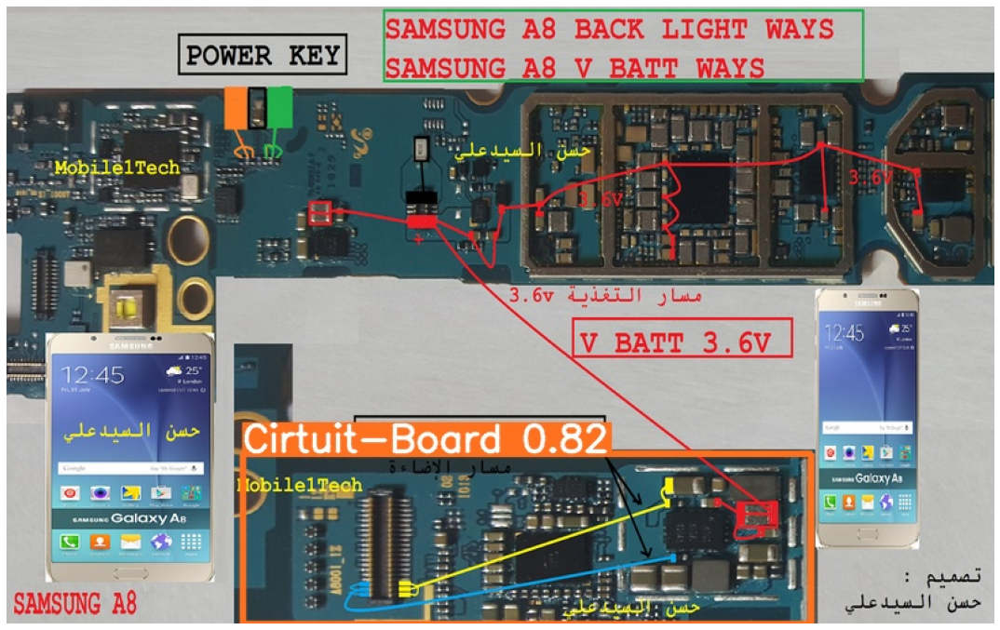

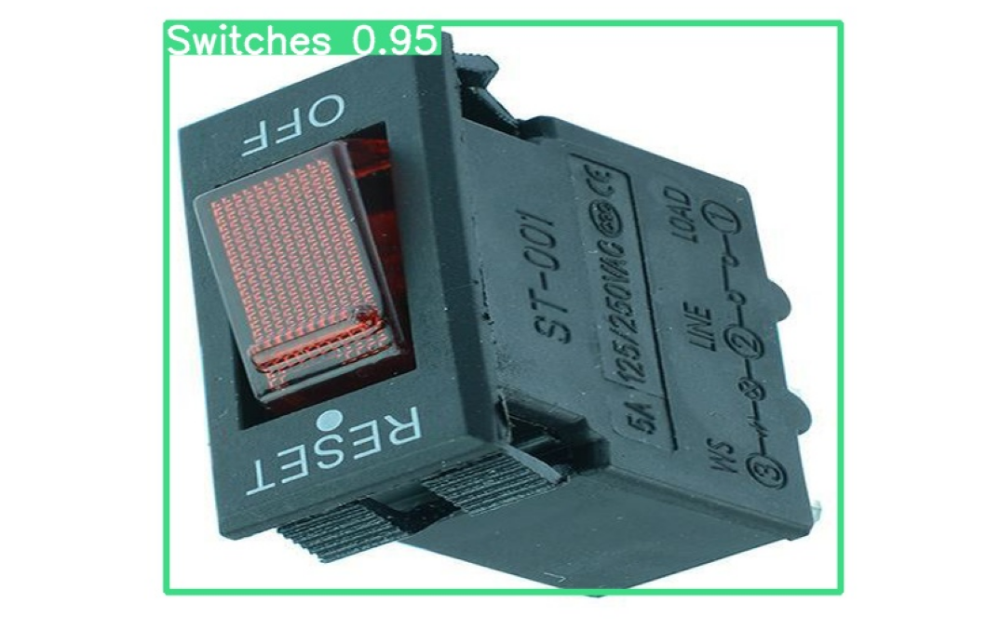

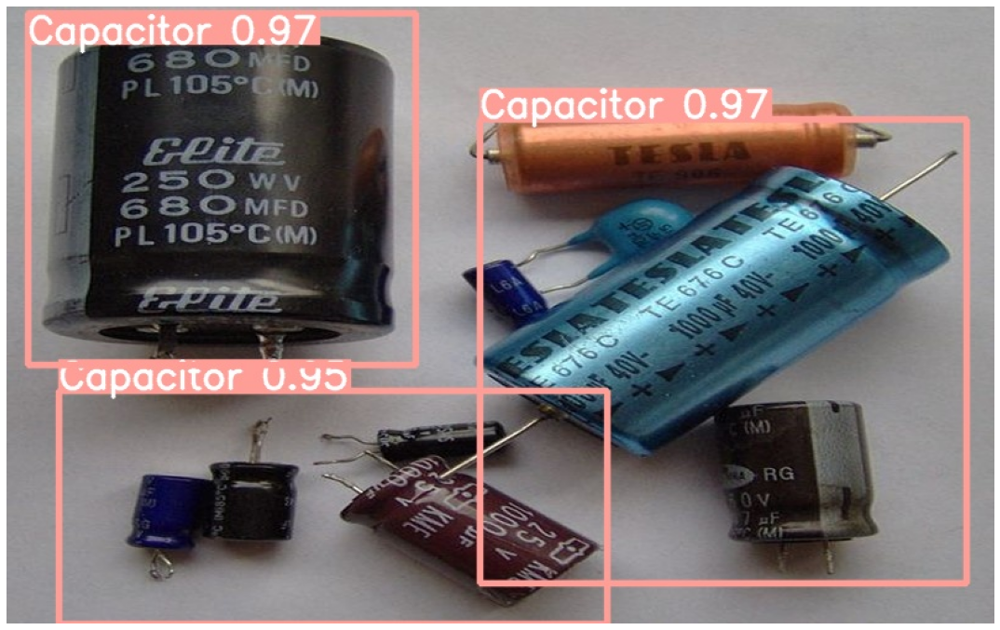

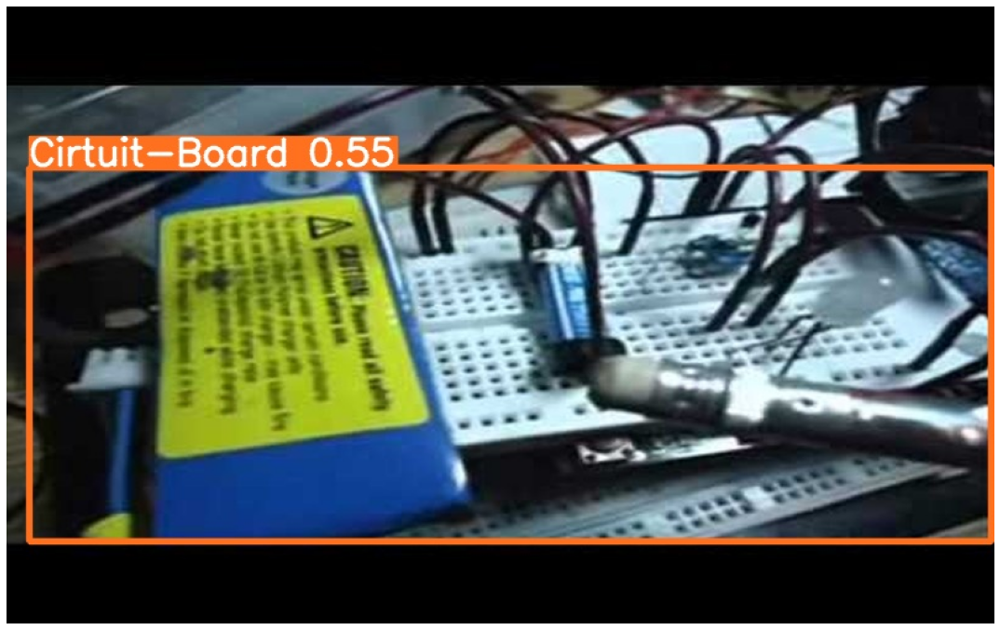

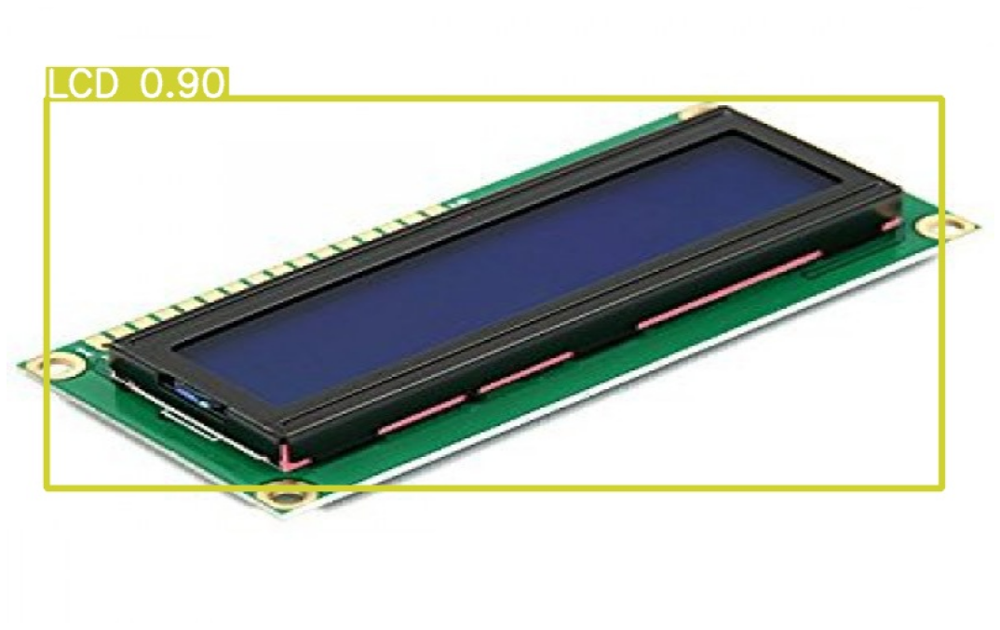

...

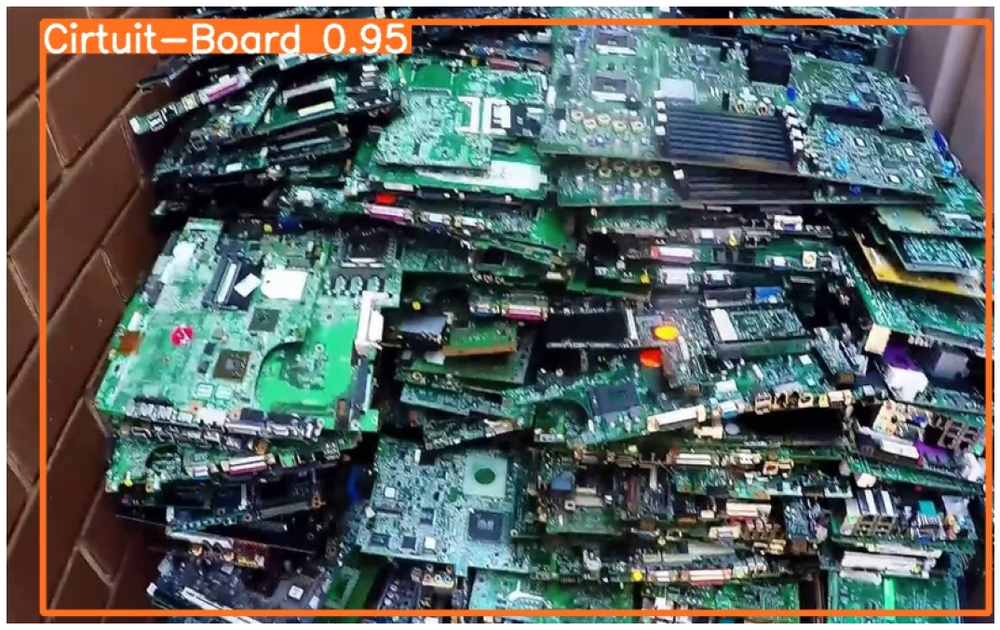

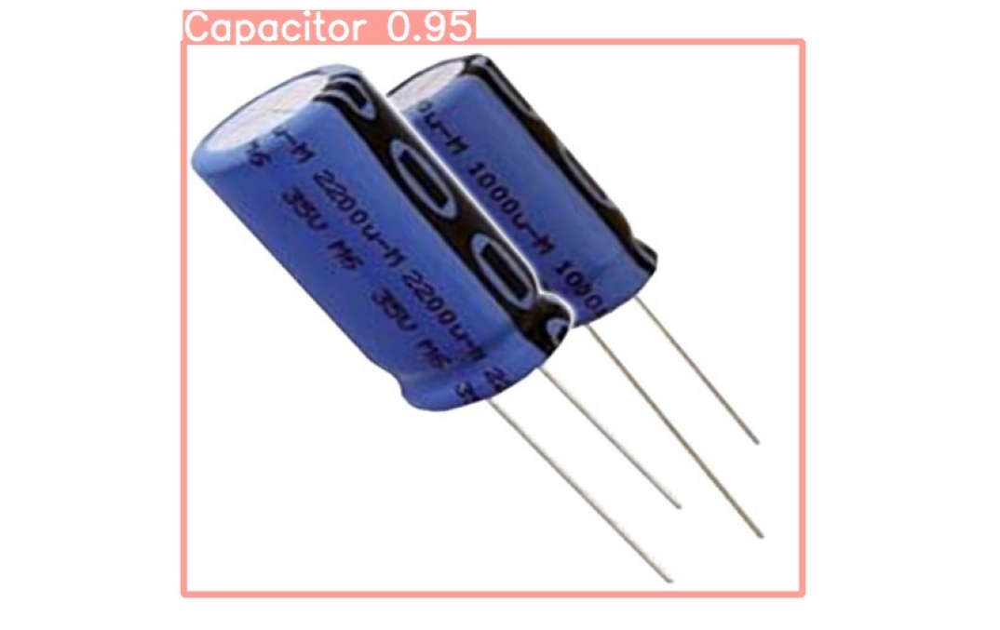

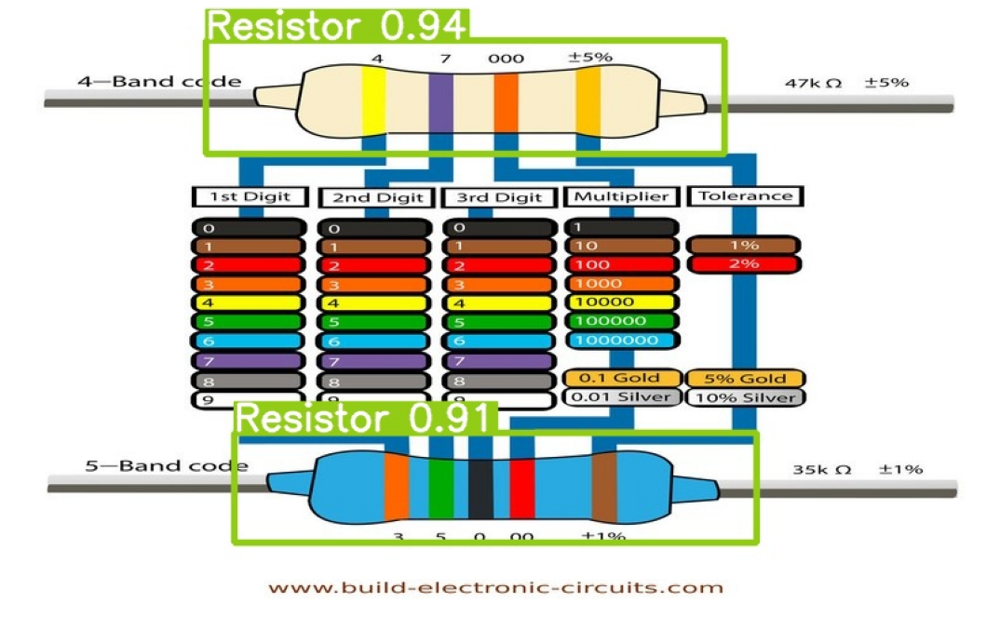

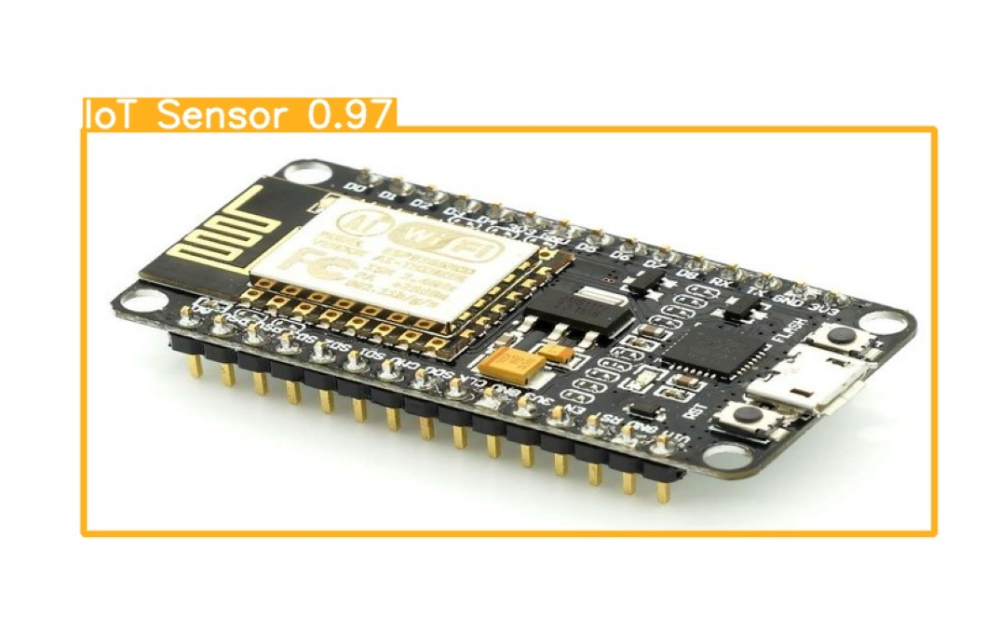

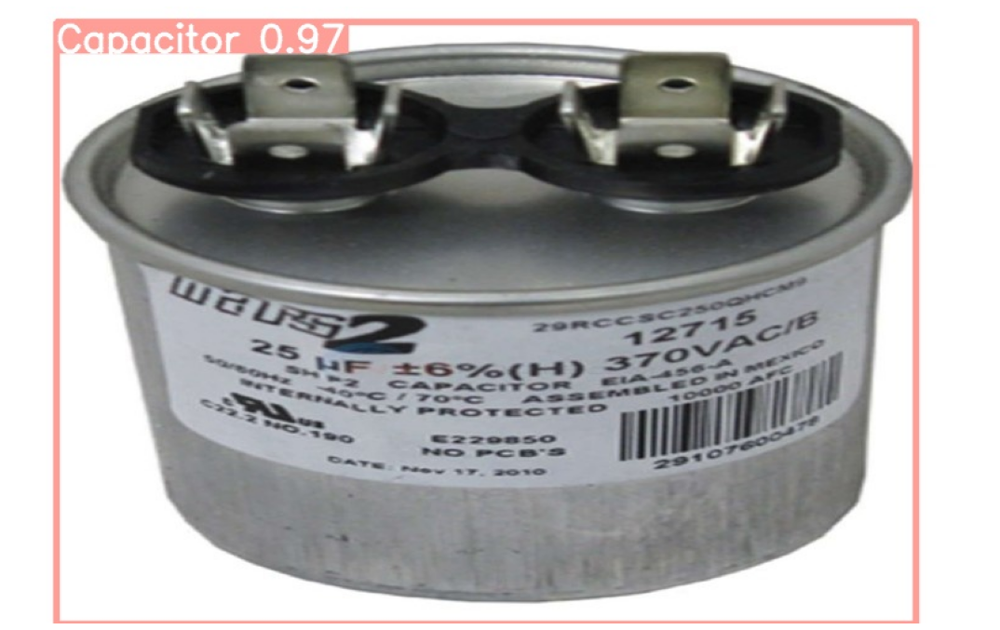

In [ ]:
visualize(IMAGE_INFER_DIR)

## Training and Inference using  Medium Model

In [ ]:
monitor_tensorboard()

In [ ]:
'''RES_DIR = set_res_dir()
if TRAIN:
    !python train.py --data ../data.yaml --weights yolov5m.pt \
    --img 640 --epochs 500 --batch-size 32 --name {RES_DIR}'''

Current number of result directories: 2
results_3
train: weights=yolov5m.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=results_3, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-49-g3c1afd9 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor

In [ ]:
# Inference on images.
IMAGE_INFER_DIR = inference(RES_DIR, '../test/images')

Current number of inference detection directories: 2
inference_3
detect: weights=['runs/train/results_3/weights/best.pt'], source=../test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=inference_3, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-49-g3c1afd9 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20881221 parameters, 0 gradients, 47.9 GFLOPs
image 1/80 /content/test/images/IoT_image_41.jpg: 416x640 1 IoT Sensor, 21.8ms
image 2/80 /content/test/images/IoT_image_42.jpg: 416x640 1 IoT Sensor, 21.6ms
image 3/80 /content/test/images/IoT_image_43.jpg: 416x640 1 IoT Sensor, 21.6ms
image 4/80 /content/test/images/IoT

In [ ]:
!zip -r /content/inference.zip /content/yolov5/runs/detect/inference_3

  adding: content/yolov5/runs/detect/inference_3/ (stored 0%)
  adding: content/yolov5/runs/detect/inference_3/cap_image_46.jpg (deflated 3%)
  adding: content/yolov5/runs/detect/inference_3/cap_image_42.jpg (deflated 9%)
  adding: content/yolov5/runs/detect/inference_3/reg_image_44.jpg (deflated 4%)
  adding: content/yolov5/runs/detect/inference_3/IoT_image_41.jpg (deflated 12%)
  adding: content/yolov5/runs/detect/inference_3/res_image_43.jpg (deflated 2%)
  adding: content/yolov5/runs/detect/inference_3/swi_image_44.jpg (deflated 3%)
  adding: content/yolov5/runs/detect/inference_3/bat_image_48.jpg (deflated 12%)
  adding: content/yolov5/runs/detect/inference_3/cap_image_45.jpg (deflated 3%)
  adding: content/yolov5/runs/detect/inference_3/bat_image_43.jpg (deflated 17%)
  adding: content/yolov5/runs/detect/inference_3/reg_image_47.jpg (deflated 20%)
  adding: content/yolov5/runs/detect/inference_3/bat_image_45.jpg (deflated 15%)
  adding: content/yolov5/runs/detect/inference_3/IoT_

## Freezing Layers and Training the Medium Model

The Medium model (yolov5m) contains 25 blocks layers in total more than 20 million parameters. We need not train all the layers. Let's freeze a few layers and train again. This will result in faster iteration per epoch. Here, we freeze the first 15 blocks.